**The 15 Most Populous Countries in The World**

**USA, Indonesia, Pakistan, Nigeria, Brazil, Bangladesh, Rusia, Ethiopia, Egypt, Japan, Mexico, Germany, Philipphines**

Animation size has reached 21141547 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


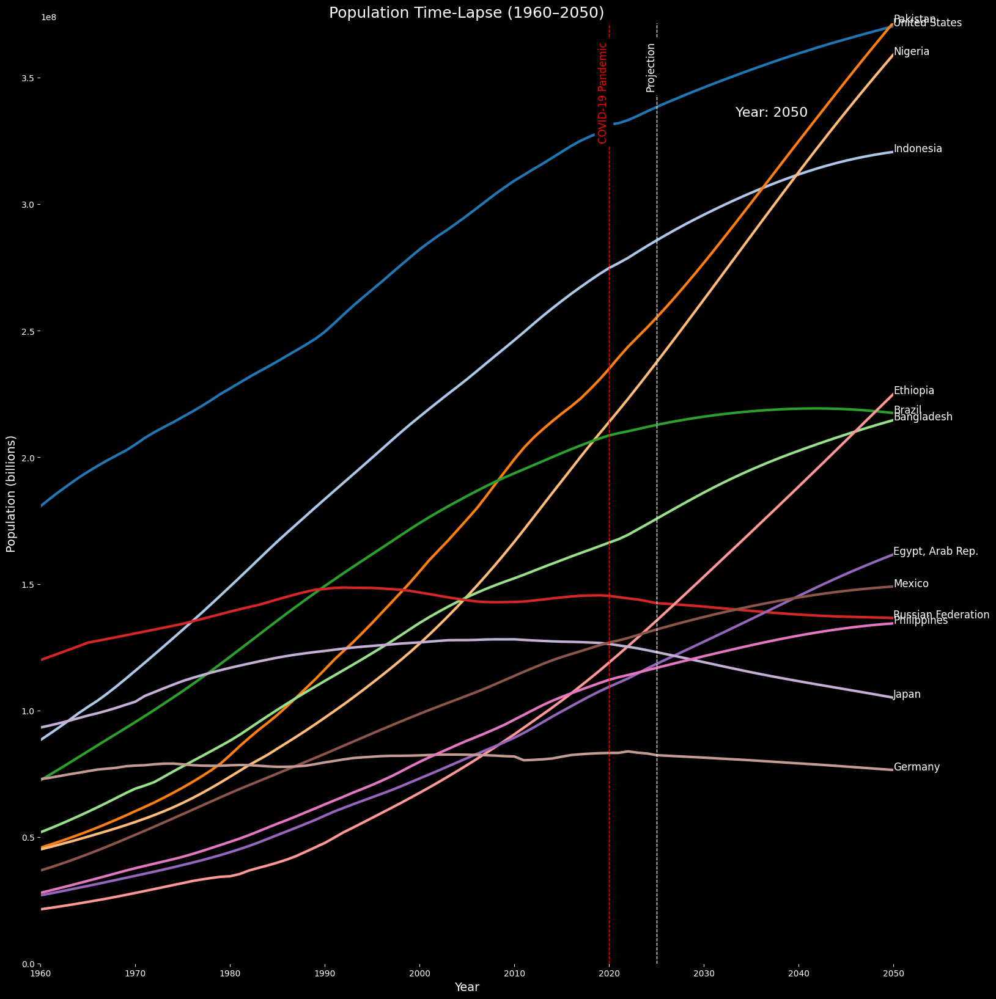

In [36]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Load cleaned long-format data
df = pd.read_csv("../data/processed/pop_total_clean.csv")

# Select countries by ISO3 code
selected_country_codes = ["USA", "IDN", "PAK", "NGA", "BRA",
                          "BGD", "RUS", "ETH", "EGY", "JPN", "MEX", "DEU", "PHL"]

# Filter and pivot
df_filtered = df[df["ISO3"].isin(selected_country_codes)]
pivot_data = df_filtered.pivot(index="Year", columns="ISO3", values="Population")
years = sorted(pivot_data.index)

# Map ISO3 to country name
iso3_to_name = df_filtered.drop_duplicates("ISO3").set_index("ISO3")["Country"].to_dict()

# Calculate max population for spacing
max_population = df_filtered["Population"].max()

# Set up dark-themed plot
fig, ax = plt.subplots(figsize=(18, 20))
fig.patch.set_facecolor('black')
ax.set_facecolor('black')
ax.tick_params(colors='white')
ax.xaxis.label.set_color('white')
ax.yaxis.label.set_color('white')
ax.title.set_color('white')

# Plot elements
lines = {}
labels = {}
for iso3 in selected_country_codes:
    lines[iso3], = ax.plot([], [], label=iso3, linewidth=3)
    lines[iso3].set_color(plt.cm.tab20(selected_country_codes.index(iso3) % 20))
    labels[iso3] = ax.text(0, 0, '', fontsize=12, color='white')

year_text = ax.text(0.9, 0.9, '', transform=ax.transAxes, fontsize=16, ha='right', color='white')

# Axes and legend
ax.set_xlim(1960, 2050)
ax.set_ylim(0, max_population * 1)
ax.set_title("Population Time-Lapse (1960–2050)", fontsize=18)
ax.set_xlabel("Year", fontsize=14)
ax.set_ylabel("Population", fontsize=14)
ax.set_ylabel("Population (billions)", fontsize=14)
# Vertical line for projection (2025)
ax.axvline(x=2025, color='white', linestyle='--', linewidth=1)
ax.text(2025, ax.get_ylim()[1]*0.98, "Projection", color='white', rotation=90,
        fontsize=12, ha='right', va='top', backgroundcolor='black')

# Vertical line for COVID-19 pandemic (2020)
ax.axvline(x=2020, color='red', linestyle='--', linewidth=1)
ax.text(2020, ax.get_ylim()[1]*0.98, "COVID-19 Pandemic", color='red', rotation=90,
        fontsize=12, ha='right', va='top', backgroundcolor='black')


# Init and animate functions
def init():
    for line in lines.values():
        line.set_data([], [])
    for label in labels.values():
        label.set_text('')
    year_text.set_text('')
    return list(lines.values()) + list(labels.values()) + [year_text]

def animate(i):
    current_years = years[:i+1]
    for iso3 in selected_country_codes:
        ydata = pivot_data[iso3].loc[current_years].values
        xdata = current_years
        lines[iso3].set_data(xdata, ydata)
        if len(xdata) > 0:
            labels[iso3].set_position((xdata[-1], ydata[-1]))
            labels[iso3].set_text(iso3_to_name[iso3])
    year_text.set_text(f"Year: {years[i]}")
    return list(lines.values()) + list(labels.values()) + [year_text]

ani = animation.FuncAnimation(
    fig, animate, frames=len(years), init_func=init,
    interval=100, blit=True, repeat=False
)

from IPython.display import HTML
HTML(ani.to_jshtml())


**China and India** 
_China and India are very large, so we separate them from the other 12 countries_

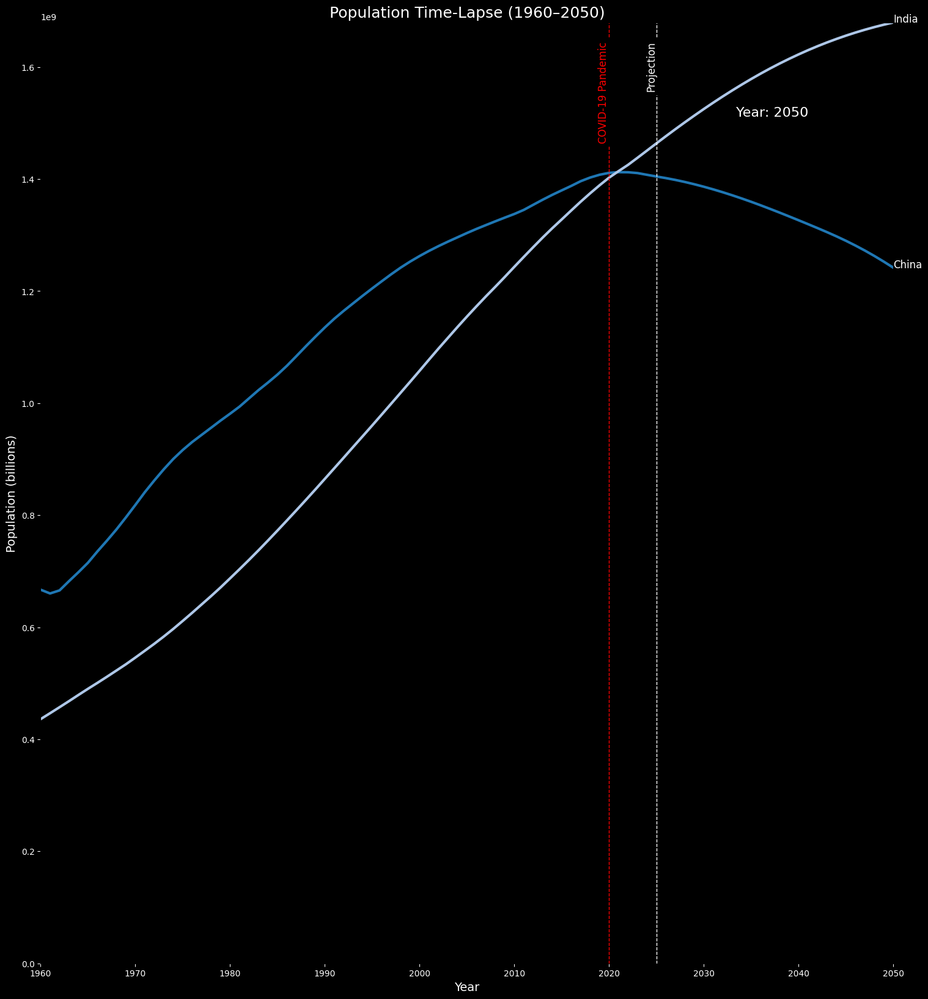

In [35]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Load cleaned long-format data
df = pd.read_csv("../data/processed/pop_total_clean.csv")

# Select countries by ISO3 code
selected_country_codes = ["CHN", "IND"]

# Filter and pivot
df_filtered = df[df["ISO3"].isin(selected_country_codes)]
pivot_data = df_filtered.pivot(index="Year", columns="ISO3", values="Population")
years = sorted(pivot_data.index)

# Map ISO3 to country name
iso3_to_name = df_filtered.drop_duplicates("ISO3").set_index("ISO3")["Country"].to_dict()

# Calculate max population for spacing
max_population = df_filtered["Population"].max()

# Set up dark-themed plot
fig, ax = plt.subplots(figsize=(18, 20))  # Bigger height = more vertical spacing
fig.patch.set_facecolor('black')
ax.set_facecolor('black')
ax.tick_params(colors='white')
ax.xaxis.label.set_color('white')
ax.yaxis.label.set_color('white')
ax.title.set_color('white')

# Plot elements
lines = {}
labels = {}
for iso3 in selected_country_codes:
    lines[iso3], = ax.plot([], [], label=iso3, linewidth=3)
    lines[iso3].set_color(plt.cm.tab20(selected_country_codes.index(iso3) % 20))
    labels[iso3] = ax.text(0, 0, '', fontsize=12, color='white')

year_text = ax.text(0.9, 0.9, '', transform=ax.transAxes, fontsize=16, ha='right', color='white')

# Axes and legend
ax.set_xlim(1960, 2050)
ax.set_ylim(0, max_population * 1)
ax.set_title("Population Time-Lapse (1960–2050)", fontsize=18)
ax.set_xlabel("Year", fontsize=14)
ax.set_ylabel("Population", fontsize=14)
ax.set_ylabel("Population (billions)", fontsize=14)
# Vertical line for projection (2025)
ax.axvline(x=2025, color='white', linestyle='--', linewidth=1)
ax.text(2025, ax.get_ylim()[1]*0.98, "Projection", color='white', rotation=90,
        fontsize=12, ha='right', va='top', backgroundcolor='black')

# Vertical line for COVID-19 pandemic (2020)
ax.axvline(x=2020, color='red', linestyle='--', linewidth=1)
ax.text(2020, ax.get_ylim()[1]*0.98, "COVID-19 Pandemic", color='red', rotation=90,
        fontsize=12, ha='right', va='top', backgroundcolor='black')


# Init and animate functions
def init():
    for line in lines.values():
        line.set_data([], [])
    for label in labels.values():
        label.set_text('')
    year_text.set_text('')
    return list(lines.values()) + list(labels.values()) + [year_text]

def animate(i):
    current_years = years[:i+1]
    for iso3 in selected_country_codes:
        ydata = pivot_data[iso3].loc[current_years].values
        xdata = current_years
        lines[iso3].set_data(xdata, ydata)
        if len(xdata) > 0:
            labels[iso3].set_position((xdata[-1], ydata[-1]))
            labels[iso3].set_text(iso3_to_name[iso3])
    year_text.set_text(f"Year: {years[i]}")
    return list(lines.values()) + list(labels.values()) + [year_text]

ani = animation.FuncAnimation(
    fig, animate, frames=len(years), init_func=init,
    interval=100, blit=True, repeat=False
)

from IPython.display import HTML
HTML(ani.to_jshtml())


**Findings from Time-Lapse Population Data (1960–2050)**

**Countries projected to keep growing until 2050:**
_These countries show substantial population increases between 2025 and 2050_
India, United States, Indonesia, Pakistan, Nigeria, Bangladesh, Ethiopia, Mexico, Egypt, Philippines


**Countries projected to decline or slowly decrease after 2025:**
_These countries either show a decrease or stagnation in population growth_
China, Brazil, Japan, Germany, Russia

**Countries experiencing population decline after the COVID-19 pandemic:**
_These countries saw an actual drop in population levels immediately following the COVID-19 pandemic, potentially due to a combination of increased mortality, declining birth rates, and reduced migration_
China, Russia, Japan
